<a href="https://colab.research.google.com/github/Yash-Yelave/AI_and_ML_Workshop-6-8-2025-/blob/main/Yolov8_Lung.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TRAINING PREPARATION

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# install ultralytics
!pip install ultralytics

In [ ]:
# Write Custom data yaml
%%writefile sesame.yaml

# path: /content/drive/MyDrive/Extra/Sesame_weed/Dataset/sesame/
# path: /content/drive/MyDrive/Sesame Weed Detection/Dataset/sesame
path: /content/drive/MyDrive/LungsCancerAug
train: /content/drive/MyDrive/LungsCancerAug/train/images
val:   /content/drive/MyDrive/LungsCancerAug/val/images
test:  /content/drive/MyDrive/LungsCancerAug/test/images

# Classes
#names:
 # 0: '0'
 # 1: '1'


nc: 3
names: ['adenocarsinoma', 'cancer', 'nodule']

Overwriting sesame.yaml


# MODEL SELECTION - CFG FILE

In [ ]:
# Write Custom model yaml
%%writefile model.yaml
nc: 3
scales:
  n: [0.33, 0.25, 1024]
  s: [0.33, 0.50, 1024]
  m: [0.67, 0.75, 768]
  l: [1.00, 1.00, 512]
  x: [1.00, 1.25, 512]

# YOLOv8.0n backbone
backbone:
  # [from, repeats, module, args]
  - [-1, 1, Conv, [64, 3, 2]]  # 0-P1/2
  - [-1, 1, Conv, [128, 3, 2]]  # 1-P2/4
  - [-1, 3, C2f, [128, True]]
  - [-1, 1, Conv, [256, 3, 2]]  # 3-P3/8
  - [-1, 6, C2f, [256, True]]
  - [-1, 1, Conv, [512, 3, 2]]  # 5-P4/16
  - [-1, 6, C2f, [512, True]]
  - [-1, 1, Conv, [1024, 3, 2]]  # 7-P5/32
  - [-1, 3, C2f, [1024, True]]
  - [-1, 1, SPPF, [1024, 5]]  # 9

# YOLOv8.0n head
head:
  - [-1, 1, nn.Upsample, [None, 2, 'nearest']]
  - [[-1, 6], 1, Concat, [1]]  # cat backbone P4
  - [-1, 3, C2f, [512]]  # 12

  - [-1, 1, nn.Upsample, [None, 2, 'nearest']]
  - [[-1, 4], 1, Concat, [1]]  # cat backbone P3
  - [-1, 3, C2f, [256]]  # 15 (P3/8-small)

  - [-1, 1, Conv, [256, 3, 2]]
  - [[-1, 12], 1, Concat, [1]]  # cat head P4
  - [-1, 3, C2f, [512]]  # 18 (P4/16-medium)

  - [-1, 1, Conv, [512, 3, 2]]
  - [[-1, 9], 1, Concat, [1]]  # cat head P5
  - [-1, 3, C2f, [1024]]  # 21 (P5/32-large)

  - [[15, 18, 21], 1, Detect, [nc]]  # Detect(P3, P4, P5)

Overwriting model.yaml


# MODEL TRAINING

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('model.yaml').load('yolov8n.pt')

# Train the model
model.train(data='sesame.yaml', epochs=10, imgsz=640)

WARNING ⚠️ no model scale passed. Assuming scale='n'.
Transferred 319/355 items from pretrained weights
Ultralytics 8.3.121 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=model.yaml, data=sesame.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=yolov8n.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, 

train: Scanning /content/drive/MyDrive/LungsCancerAug/train/labels.cache... 980 images, 0 backgrounds, 0 corrupt: 100%|██████████| 980/980 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 3.6±4.1 ms, read: 22.5±20.0 MB/s, size: 55.5 KB)


val: Scanning /content/drive/MyDrive/LungsCancerAug/val/labels.cache... 140 images, 0 backgrounds, 0 corrupt: 100%|██████████| 140/140 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.03G      1.904      4.488       1.38          4        640: 100%|██████████| 62/62 [00:21<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.80it/s]

                   all        140        142    0.00219      0.601      0.283      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.51G      1.661       2.82      1.228          4        640: 100%|██████████| 62/62 [00:21<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]


                   all        140        142      0.561      0.679      0.664      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.51G      1.635      2.293      1.222          4        640: 100%|██████████| 62/62 [00:19<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.31it/s]

                   all        140        142       0.57      0.694       0.66      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.52G      1.542      1.863       1.17          4        640: 100%|██████████| 62/62 [00:19<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]


                   all        140        142      0.593      0.756      0.682      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.53G        1.5      1.579       1.16          4        640: 100%|██████████| 62/62 [00:18<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.32it/s]

                   all        140        142      0.782      0.775       0.78      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.54G      1.491      1.382      1.156          4        640: 100%|██████████| 62/62 [00:19<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.06it/s]

                   all        140        142      0.922      0.778      0.842      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.55G      1.428      1.224      1.107          4        640: 100%|██████████| 62/62 [00:18<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.30it/s]

                   all        140        142      0.761      0.878      0.902      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.55G      1.358      1.084      1.086          4        640: 100%|██████████| 62/62 [00:19<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.15it/s]

                   all        140        142      0.968      0.932      0.974      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      2.55G      1.316     0.9764      1.053          4        640: 100%|██████████| 62/62 [00:18<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.18it/s]

                   all        140        142      0.957      0.904      0.968       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.55G      1.271     0.9252      1.039          4        640: 100%|██████████| 62/62 [00:19<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]

                   all        140        142      0.949      0.918      0.974       0.76



10 epochs completed in 0.060 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.121 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
model summary (fused): 72 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.70it/s]


                   all        140        142      0.949      0.917      0.974      0.758
        adenocarsinoma         16         16      0.974          1      0.995      0.854
                cancer         17         17      0.874      0.824      0.942      0.801
                nodule        107        109          1      0.928      0.985      0.621
Speed: 0.3ms preprocess, 2.3ms inference, 0.0ms loss, 5.4ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c8edc34bfd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04

# VISUALIZATION ON TENSORBOARD

In [ ]:
# Visualization on tensorboard
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/LungsCancerAug/Results/runs/detect/train' --port 8055 --host 0.0.0.0

<IPython.core.display.Javascript object>

In [ ]:
# Load TensorBoard extension (only once)
%load_ext tensorboard

# Run TensorBoard on a different port
%tensorboard --logdir '/content/drive/MyDrive/LungSCancerAug/Results/runs/detect/train' --port 8056 --host 0.0.0.0



<IPython.core.display.Javascript object>

In [ ]:
import shutil
# 3. Locate the latest run directory
runs_dir = '/content/runs/detect'
latest_run = sorted(os.listdir(runs_dir))[-1]  # Get the most recent run folder

# 4. Define Google Drive destination
dest_path = f'/content/drive/MyDrive/YoloResults/{latest_run}'

# 5. Copy the results folder to Google Drive
shutil.copytree(os.path.join(runs_dir, latest_run), dest_path)

print(f"Results saved to Google Drive at: {dest_path}")

Results saved to Google Drive at: /content/drive/MyDrive/YoloResults/train2


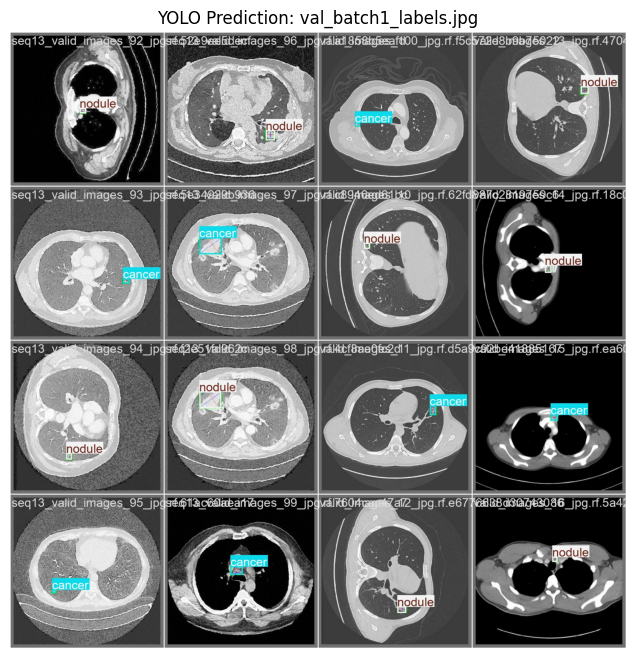

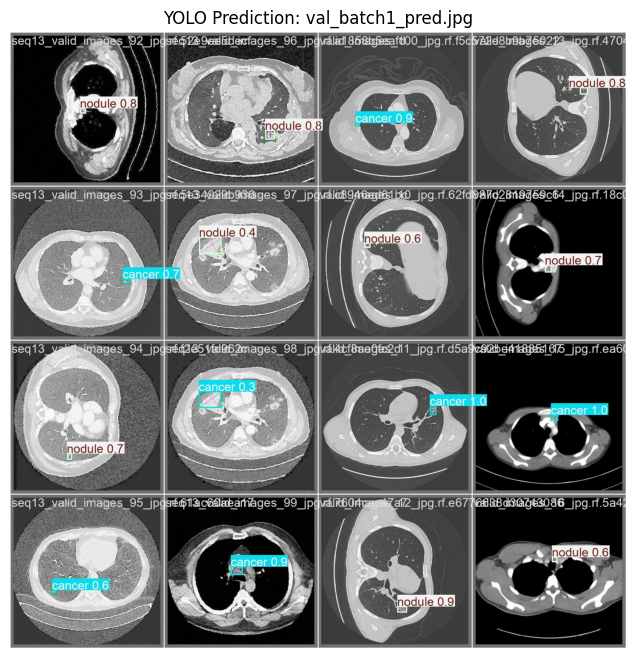

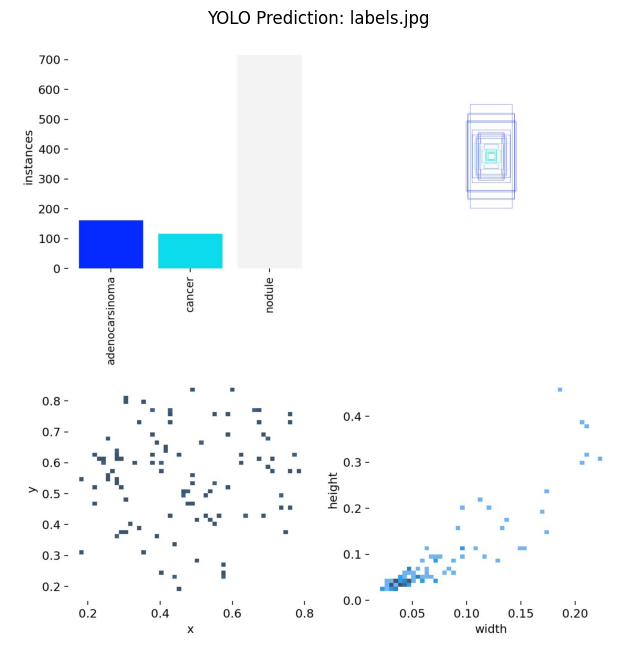

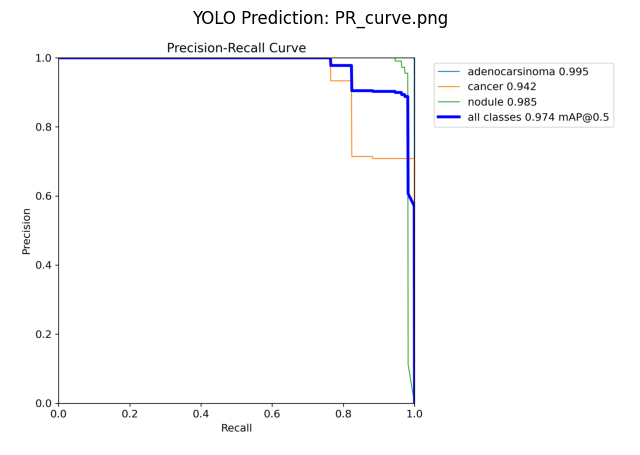

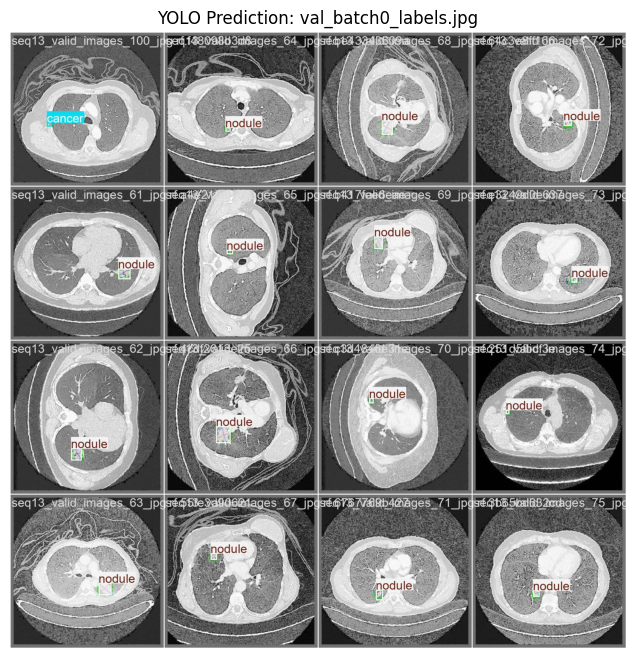

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# Path to YOLO predictions
pred_dir = '/content/drive/MyDrive/YoloResults/train2'
image_files = [f for f in os.listdir(pred_dir) if f.endswith(('.jpg', '.png'))]

# Display first few prediction results
for img_file in image_files[:5]:  # Change number to display more
    img_path = os.path.join(pred_dir, img_file)
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(8, 8))
    plt.imshow(img_rgb)
    plt.title(f"YOLO Prediction: {img_file}")
    plt.axis('off')
    plt.show()


# INFERENCE USING PYTORCH

In [ ]:
# Convert model onto onnx format
from ultralytics import YOLO

model = YOLO('/content/drive/MyDrive/LungsCancerAug/Results/runs/detect/train/weights/best.pt')
image_path = '/content/drive/MyDrive/LungsCancerAug/val/images/y0_jpg.rf.aa5b1a4d9545c01cbaa3ad7743618c0e'

model.predict(image_path, save=True, imgsz=640, conf=0.5)


image 1/1 /content/drive/MyDrive/LungsCancerAug/val/images/seq13_valid_images_100_jpg.rf.f48098b3d8d43a3f0365e89f15828373.jpg: 640x640 (no detections), 9.7ms
Speed: 2.9ms preprocess, 9.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict6


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'adenocarsinoma', 1: 'cancer', 2: 'nodule'}
 obb: None
 orig_img: array([[[61, 61, 61],
         [66, 66, 66],
         [71, 71, 71],
         ...,
         [44, 44, 44],
         [39, 39, 39],
         [40, 40, 40]],
 
        [[60, 60, 60],
         [61, 61, 61],
         [61, 61, 61],
         ...,
         [58, 58, 58],
         [57, 57, 57],
         [61, 61, 61]],
 
        [[62, 62, 62],
         [60, 60, 60],
         [57, 57, 57],
         ...,
         [61, 61, 61],
         [64, 64, 64],
         [69, 69, 69]],
 
        ...,
 
        [[37, 37, 37],
         [61, 61, 61],
         [63, 63, 63],
         ...,
         [64, 63, 65],
         [64, 63, 65],
         [17, 16, 18]],
 
        [[61, 61, 61],
         [66, 66, 66],
         [61, 61, 61],
         ...,
         [61, 60, 64],
         [64, 63, 67],
         [16, 15, 1

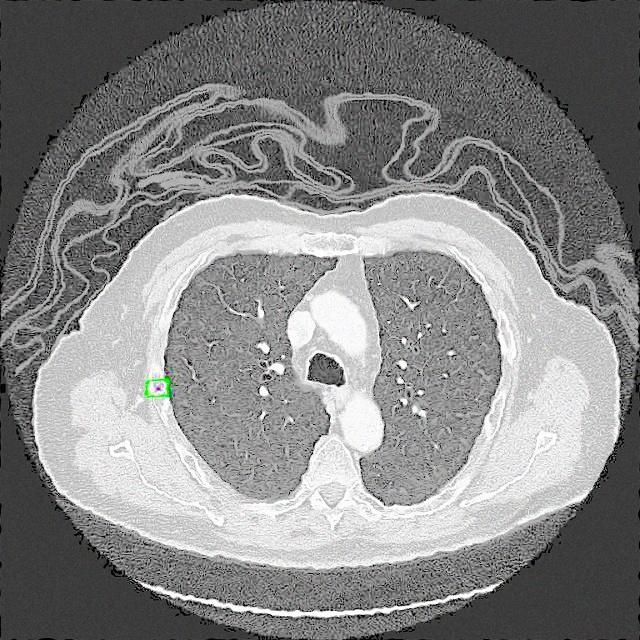

In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'/content/runs/detect/predict/seq13_valid_images_100_jpg.rf.f48098b3d8d43a3f0365e89f15828373.jpg', width=600)

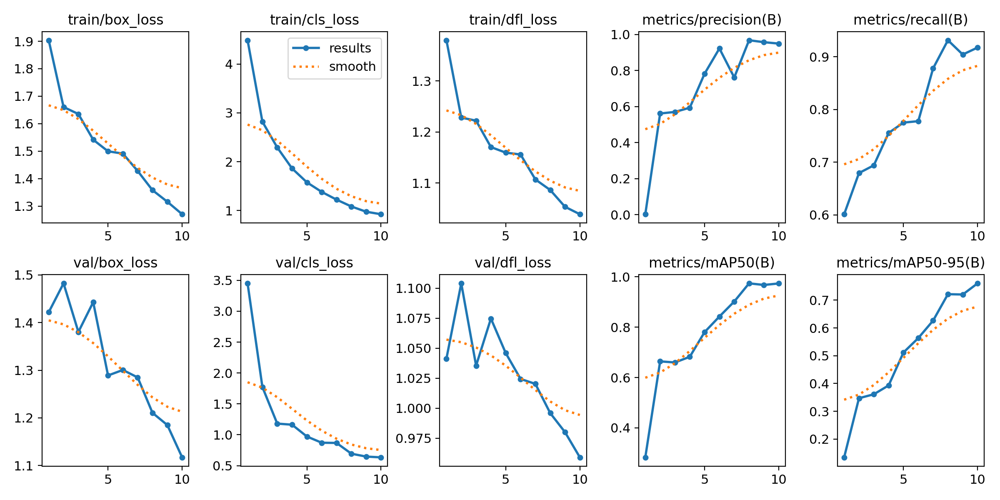

In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'/content/drive/MyDrive/YoloResults/train2/results.png', width=600)

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/YoloResults/train2/weights/best.pt conf=0.25 source=/content/drive/MyDrive/LungsCancerAug/test/images save=True

Ultralytics 8.3.121 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
model summary (fused): 72 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs

image 1/280 /content/drive/MyDrive/LungsCancerAug/test/images/seq10_valid_images_100_jpg.rf.872803dd4691cbf2b9a22c603419670f.jpg: 640x640 1 cancer, 8.5ms
image 2/280 /content/drive/MyDrive/LungsCancerAug/test/images/seq10_valid_images_81_jpg.rf.0b5a795bac29c7b10e7934e993213531.jpg: 640x640 1 nodule, 7.5ms
image 3/280 /content/drive/MyDrive/LungsCancerAug/test/images/seq10_valid_images_82_jpg.rf.3de98fc80ae376dbc189033b6ace3d91.jpg: 640x640 1 nodule, 7.4ms
image 4/280 /content/drive/MyDrive/LungsCancerAug/test/images/seq10_valid_images_83_jpg.rf.8fd6f1abe53ad087f15f162054031fe6.jpg: 640x640 1 nodule, 7.4ms
image 5/280 /content/drive/MyDrive/LungsCancerAug/test/images/seq10_valid_images_84_jpg.rf.35f142130a8b24099b1cd17485cb9ad1.jpg: 640x640 1 nodule, 7.4ms
image 6/280 /content/drive/MyDrive/LungsCancerAug/test/images/seq10_va

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/YoloResults/train2/weights/best.pt conf=0.25 source=/content/drive/MyDrive/LungsCancerAug/val/images save=True

Ultralytics 8.3.121 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
model summary (fused): 72 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs

image 1/140 /content/drive/MyDrive/LungsCancerAug/val/images/seq13_valid_images_100_jpg.rf.f48098b3d8d43a3f0365e89f15828373.jpg: 640x640 1 cancer, 8.4ms
image 2/140 /content/drive/MyDrive/LungsCancerAug/val/images/seq13_valid_images_61_jpg.rf.a4e215f9407cdd56287b330e6c59cb7b.jpg: 640x640 1 nodule, 13.0ms
image 3/140 /content/drive/MyDrive/LungsCancerAug/val/images/seq13_valid_images_62_jpg.rf.4cdf2813e25949c7b5d3cecc77ed9469.jpg: 640x640 1 nodule, 7.4ms
image 4/140 /content/drive/MyDrive/LungsCancerAug/val/images/seq13_valid_images_63_jpg.rf.55fe3d9062140d4eec8de9e7680d0fd5.jpg: 640x640 1 nodule, 9.0ms
image 5/140 /content/drive/MyDrive/LungsCancerAug/val/images/seq13_valid_images_64_jpg.rf.be43343609ab67b4444bad1f1cf23f30.jpg: 640x640 1 nodule, 7.4ms
image 6/140 /content/drive/MyDrive/LungsCancerAug/val/images/seq13_valid_i

# MODEL CONVERSION - ONNX

In [ ]:
# Convert model onto onnx format
from ultralytics import YOLO

model = YOLO('/content/runs/detect/train/weights/best.pt')
model.export(format='onnx', imgsz=(640,640), half=True, simplify=True)

Ultralytics 8.3.121 🚀 Python-3.11.12 torch-2.6.0+cu124 CPU (Intel Xeon 2.00GHz)
WARNING ⚠️ half=True only compatible with GPU export, i.e. use device=0
model summary (fused): 72 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from '/content/runs/detect/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 7, 8400) (6.0 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0', 'onnxslim>=0.1.46', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 177.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.5/144.5 kB 132.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 280.8/280.8 MB 146.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 229.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 275.3 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 17.2s, installed 3 packages: ['onnx>=1.12.0', 'on

'/content/runs/detect/train/weights/best.onnx'

# INFERENCE - ONNX

In [ ]:
# Insatll Dependencies
!pip install onnxruntime
!pip install onnxruntime-gpu

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 58.0 MB/s eta 0:00:00


## ON IMAGE

## ON VIDEO

In [ ]:
path_video_file = '/content/drive/MyDrive/Freelancing/Inside a battery plant.mp4'
cap = cv2.VideoCapture(path_video_file)
writer = True
show = False
frame_no = 0

if (cap.isOpened()== False):
    print("Error opening video stream or file")

frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

if writer:
    out = cv2.VideoWriter('result.avi',cv2.VideoWriter_fourcc('M','J','P','G'), 25, (frame_width,frame_height))

total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print(f'Total frames in video: {total_frames}')

while(cap.isOpened()):
    ret, frame = cap.read()
    if ret == True:
        start = time.time()
        frame_no += 1
        image = infer_image(frame.copy())

        if writer:
            out.write(image[:,:,::-1])
        if show:
            cv2.imshow('frame',image[:,:,::-1])

            if cv2.waitKey(1) & 0xFF == ord('q'):
                break
        end = time.time()
        print(f'Expected time to complete remaining {total_frames - frame_no} frame(s) is {(total_frames - frame_no) * (end - start)} sec')
    else:
        break

cap.release()
if writer:
    out.release()

# MODEL CONVERSION - TENSORRT

# INFERENCE USING TENSORRT

In [ ]:
# Import necessary packages
import tensorrt as trt
import pycuda.autoinit
import pycuda.driver as cuda
import numpy as np
import cv2
from PIL import Image

In [ ]:
# Define function for pre-process image
def preproc(image, input_size, mean, std, swap=(2, 0, 1)):
    if len(image.shape) == 3:
        padded_img = np.ones((input_size[0], input_size[1], 3)) * 114.0
    else:
        padded_img = np.ones(input_size) * 114.0
    img = np.array(image)
    r = min(input_size[0] / img.shape[0], input_size[1] / img.shape[1])
    resized_img = cv2.resize(
        img,
        (int(img.shape[1] * r), int(img.shape[0] * r)),
        interpolation=cv2.INTER_LINEAR,
    ).astype(np.float32)
    padded_img[: int(img.shape[0] * r), : int(img.shape[1] * r)] = resized_img

    padded_img = padded_img[:, :, ::-1]
    padded_img /= 255.0
    if mean is not None:
        padded_img -= mean
    if std is not None:
        padded_img /= std
    padded_img = padded_img.transpose(swap)
    padded_img = np.ascontiguousarray(padded_img, dtype=np.float32)
    return padded_img, r

# Define function for visualization
def vis(img, boxes, scores, cls_ids, conf=0.5, class_names=None):
    for i in range(len(boxes)):
        box = boxes[i]
        cls_id = int(cls_ids[i])
        score = scores[i]
        if score < conf:
            continue
        x0 = int(box[0])
        y0 = int(box[1])
        x1 = int(box[2])
        y1 = int(box[3])

        color = (_COLORS[cls_id % 80] * 255).astype(np.uint8).tolist()
        text = '{}:{:.1f}%'.format(class_names[cls_id], score * 100)
        txt_color = (0, 0, 0) if np.mean(_COLORS[cls_id % 80]) > 0.5 else (255, 255, 255)
        font = cv2.FONT_HERSHEY_SIMPLEX

        txt_size = cv2.getTextSize(text, font, 0.4, 1)[0]
        cv2.rectangle(img, (x0, y0), (x1, y1), color, 2)

        txt_bk_color = (_COLORS[cls_id % 80] * 255 * 0.7).astype(np.uint8).tolist()
        cv2.rectangle(
            img,
            (x0, y0 + 1),
            (x0 + txt_size[0] + 1, y0 + int(1.5 * txt_size[1])),
            txt_bk_color,
            -1
        )
        cv2.putText(img, text, (x0, y0 + txt_size[1]), font, 0.4, txt_color, thickness=1)

    return img

In [ ]:
# Define class for inference
class BaseEngine(object):
    def __init__(self, engine_path, imgsz=(640,640)):
        self.imgsz = imgsz
        self.mean = None
        self.std = None
        self.class_names = [ '0', '1' ]
        logger = trt.Logger(trt.Logger.WARNING)
        trt.init_libnvinfer_plugins(logger,'')
        runtime = trt.Runtime(logger)
        with open(engine_path, "rb") as f:
            serialized_engine = f.read()
        engine = runtime.deserialize_cuda_engine(serialized_engine)
        self.context = engine.create_execution_context()
        self.inputs, self.outputs, self.bindings = [], [], []
        self.stream = cuda.Stream()
        for binding in engine:
            size = trt.volume(engine.get_binding_shape(binding))
            dtype = trt.nptype(engine.get_binding_dtype(binding))
            host_mem = cuda.pagelocked_empty(size, dtype)
            device_mem = cuda.mem_alloc(host_mem.nbytes)
            self.bindings.append(int(device_mem))
            if engine.binding_is_input(binding):
                self.inputs.append({'host': host_mem, 'device': device_mem})
            else:
                self.outputs.append({'host': host_mem, 'device': device_mem})

    def infer(self, img):
        self.inputs[0]['host'] = np.ravel(img)
        # transfer data to the gpu
        for inp in self.inputs:
            cuda.memcpy_htod_async(inp['device'], inp['host'], self.stream)
        # run inference
        self.context.execute_async_v2(
            bindings=self.bindings,
            stream_handle=self.stream.handle)
        # fetch outputs from gpu
        for out in self.outputs:
            cuda.memcpy_dtoh_async(out['host'], out['device'], self.stream)
        # synchronize stream
        self.stream.synchronize()

        data = [out['host'] for out in self.outputs]
        return data

    def inference(self, img, conf=0.25):
        origin_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img, ratio = preproc(origin_img, self.imgsz, self.mean, self.std)
        num, final_boxes, final_scores, final_cls_inds = self.infer(img)
        final_boxes = np.reshape(final_boxes, (-1, 4))
        num = num[0]
        if num >0:
            final_boxes, final_scores, final_cls_inds = final_boxes[:num]/ratio, final_scores[:num], final_cls_inds[:num]
            origin_img = vis(origin_img, final_boxes, final_scores, final_cls_inds,
                             conf=conf, class_names=self.class_names)
        origin_img = cv2.cvtColor(origin_img, cv2.COLOR_RGB2BGR)
        return origin_img

    def get_fps(self):
        # warmup
        import time
        img = np.ones((1,3,self.imgsz[0], self.imgsz[1]))
        img = np.ascontiguousarray(img, dtype=np.float32)
        for _ in range(20):
            _ = self.infer(img)
        t1 = time.perf_counter()
        _ = self.infer(img)
        print(1/(time.perf_counter() - t1), 'FPS')

In [ ]:
# Define colors
_COLORS = np.array(
    [
        0.000, 0.447, 0.741,
        0.850, 0.325, 0.098
    ]
).astype(np.float32).reshape(-1, 3)

pred = BaseEngine(engine_path='/content/runs/detect/train/weights/best.engine')

## ON IMAGE

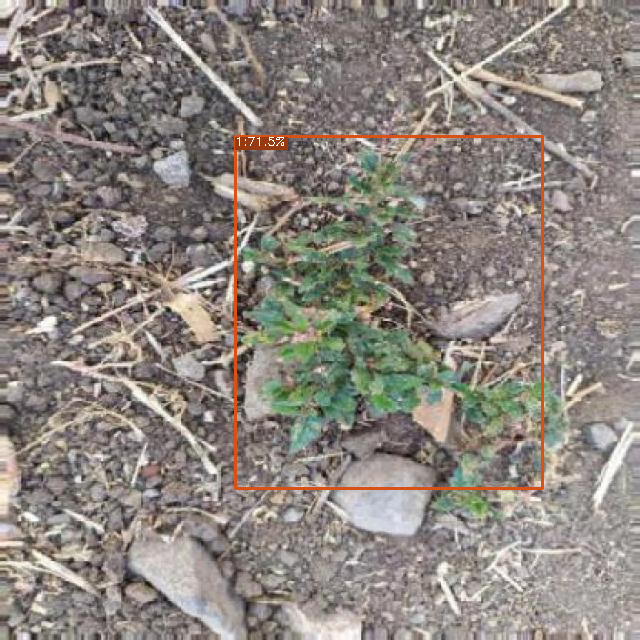

In [ ]:
# Read image
image_path = '/content/drive/MyDrive/Extra/Sesame_weed/Dataset/sesame/images/val/agri_0_1009_jpeg_jpg.rf.1cc8f8f52d46782f5104c1b75e8ff4b0.jpg'
img = cv2.imread(image_path)
origin_img = pred.inference(img)
Image.fromarray(origin_img[:, :, ::-1])

In [ ]:
pred.get_fps()

70.23588088345048 FPS


## ON VIDEO

In [ ]:
path_video_file = '/content/drive/MyDrive/Freelancing/Inside a battery plant.mp4'
cap = cv2.VideoCapture(path_video_file)
writer = True
show = False
frame_no = 0

if (cap.isOpened()== False):
    print("Error opening video stream or file")

frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

if writer:
    out = cv2.VideoWriter('result.avi',cv2.VideoWriter_fourcc('M','J','P','G'), 25, (frame_width,frame_height))

total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print(f'Total frames in video: {total_frames}')

while(cap.isOpened()):
    ret, frame = cap.read()
    if ret == True:
        start = time.time()
        frame_no += 1
        image = pred.inference(frame)

        if writer:
            out.write(image)
        if show:
            cv2.imshow('frame',image)

            if cv2.waitKey(1) & 0xFF == ord('q'):
                break
        end = time.time()
        print(f'Expected time to complete remaining {total_frames - frame_no} frame(s) is {(total_frames - frame_no) * (end - start)} sec')
    else:
        break

cap.release()
if writer:
    out.release()